## One-Dimensional Diffusion Equation and Its Solution Using Finite Difference

The one-dimensional diffusion equation describes how a quantity such as heat or concentration diffuses through a medium over time. It is given by:

$
\frac{\partial u}{\partial t} = D \frac{\partial^2 u}{\partial x^2}
$

where:
- \( u(x, t) \) is the quantity of interest (e.g., temperature or concentration) at position \( x \) and time \( t \),
- \( D \) is the diffusion coefficient.

### Finite Difference Solution

To solve this equation numerically, we discretize both time and space:
- Divide the spatial domain into grid points with spacing $( \Delta x )$,
- Divide the time domain into steps of size $( \Delta t )$.

The finite difference approximation for the spatial second derivative is:

$
\frac{\partial^2 u}{\partial x^2} \approx \frac{u_{i+1}^n - 2u_i^n + u_{i-1}^n}{(\Delta x)^2}
$

The time derivative is approximated as:

$
\frac{\partial u}{\partial t} \approx \frac{u_i^{n+1} - u_i^n}{\Delta t}
$

Combining these, the explicit finite difference scheme becomes:

$
u_i^{n+1} = u_i^n + \frac{D \Delta t}{(\Delta x)^2} (u_{i+1}^n - 2u_i^n + u_{i-1}^n)
$

This formula allows us to compute the value of \( u \) at each grid point and time step, given initial and boundary conditions.

In [6]:
# Important libraries
import os
import sys
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


In [7]:


# Parameters
D = 1.0         # Diffusion coefficient
L = 10.0        # Length of the domain
T = 1.0         # Total time
Nx = 101        # Number of spatial points
Nt = 500        # Number of time steps

dx = L / (Nx - 1)
dt = T / Nt
x = np.linspace(0, L, Nx)

# Stability parameter
alpha = D * dt / dx**2

# Initial condition: u(x,0) = sin(pi*x/L)
u = np.sin(np.pi * x / L)

# Boundary conditions: u(0,t) = u(L,t) = 0
u[0] = u[-1] = 0

# Store all intermediate values
u_all = [u.copy()]

# Time-stepping loop
for n in range(Nt):
    u_new = u.copy()
    u_new[1:-1] = u[1:-1] + alpha * (u[2:] - 2*u[1:-1] + u[:-2])
    u = u_new
    u_all.append(u.copy())



In [ ]:
# Create an animation of the diffusion process
fig, ax = plt.subplots()
line, = ax.plot(x, u_all[0])
ax.set_xlim(0, L)
ax.set_ylim(0, 1)
ax.set_xlabel('x')
ax.set_ylabel('u')
ax.set_title('1D Diffusion Equation Evolution (t=0.000)')

def update(frame):
    line.set_ydata(u_all[frame])
    ax.set_title(f'1D Diffusion Equation Evolution (t={frame*dt:.3f})')
    return line, ax

ani = FuncAnimation(fig, update, frames=len(u_all), interval=30, blit=False)
plt.close(fig)
HTML(ani.to_jshtml())


In [10]:
# Generate a dataset for varying diffusion coefficient D and store all data in a snapshot matrix

D_values = np.linspace(0.1, 2.0, 10)  # 10 values of D from 0.1 to 2.0
snapshot_matrix = []

for D_var in D_values:
    alpha_var = D_var * dt / dx**2
    u_var = np.sin(np.pi * x / L)
    u_var[0] = u_var[-1] = 0
    u_var_all = [u_var.copy()]
    for _ in range(Nt):
        u_new_var = u_var.copy()
        u_new_var[1:-1] = u_var[1:-1] + alpha_var * (u_var[2:] - 2*u_var[1:-1] + u_var[:-2])
        u_var = u_new_var
        u_var_all.append(u_var.copy())
    snapshot_matrix.append(np.array(u_var_all))

snapshot_matrix = np.array(snapshot_matrix).reshape(-1,Nx).T
print("Snapshot matrix shape:", snapshot_matrix.shape)

Snapshot matrix shape: (101, 5010)


## Proper Orthogonal Decomposition (POD) and Dominant Modes via SVD

**Proper Orthogonal Decomposition (POD)** is a powerful technique used to extract the most energetic structures (modes) from a dataset, often applied in fluid dynamics, signal processing, and data-driven modeling. POD seeks an optimal set of orthogonal basis functions that best represent the data in a least-squares sense.

### Steps for POD Using Singular Value Decomposition (SVD)

1. **Snapshot Matrix Construction**:  
    Collect the system states (e.g., solutions at different times or parameter values) into a matrix, called the snapshot matrix. Each column (or row) represents a snapshot.

2. **Singular Value Decomposition (SVD)**:  
    Apply SVD to the snapshot matrix \( X \):
    $$
    X = U \Sigma V^T
    $$
    - $( U )$: Left singular vectors (spatial modes)
    - $( \Sigma )$: Diagonal matrix of singular values (energy content)
    - $( V )$: Right singular vectors (temporal or parameter modes)

3. **Identifying Dominant Modes**:  
    The singular values in $( \Sigma )$ indicate the energy captured by each mode. The dominant modes correspond to the largest singular values. By selecting the first few modes (those with the largest singular values), one can capture most of the system's dynamics with reduced complexity.

### Summary

- **POD** provides an optimal low-dimensional representation of high-dimensional data.
- **SVD** is the standard computational tool for performing POD.
- **Dominant modes** are identified by the largest singular values and their corresponding singular vectors, representing the most significant patterns in the data.

In [13]:
# Subtract the mean from the snapshot matrix (mean over time/parameters, i.e., columns)
mean_snapshot = np.mean(snapshot_matrix, axis=1, keepdims=True)
print("Mean snapshot shape:", mean_snapshot.shape)
X_centered = snapshot_matrix - mean_snapshot

# Perform Singular Value Decomposition (SVD)
U, S, VT = np.linalg.svd(X_centered, full_matrices=False)

# U: spatial modes (POD modes), S: singular values, VT: temporal/parameter modes
print("U shape (spatial modes):", U.shape)
print("S shape (singular values):", S.shape)
print("VT shape (temporal/parameter modes):", VT.shape)

Mean snapshot shape: (101, 1)
U shape (spatial modes): (101, 101)
S shape (singular values): (101,)
VT shape (temporal/parameter modes): (101, 5010)


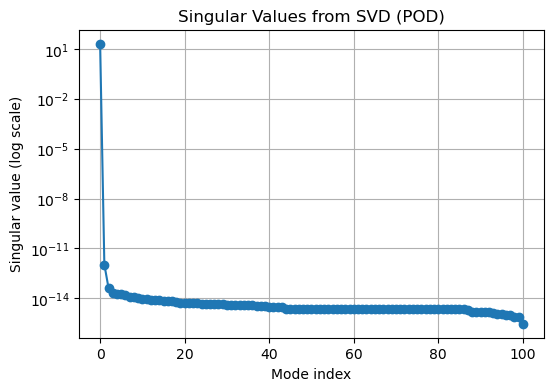

In [14]:
plt.figure(figsize=(6,4))
plt.semilogy(S, 'o-')
plt.xlabel('Mode index')
plt.ylabel('Singular value (log scale)')
plt.title('Singular Values from SVD (POD)')
plt.grid(True)
plt.show()

In [16]:
# Calculate the cumulative energy captured by the singular values
cumulative_energy = np.cumsum(S**2) / np.sum(S**2)

# Find the number of modes required to capture at least 99% variance
num_modes_99 = np.searchsorted(cumulative_energy, 0.9999) + 1
print(f"Number of modes to capture 99% variance: {num_modes_99}")

Number of modes to capture 99% variance: 1


### Selecting the Number of Modes to Capture 99% Variance

In Proper Orthogonal Decomposition (POD), the singular values obtained from the Singular Value Decomposition (SVD) represent the "energy" or variance captured by each mode. To efficiently reduce the dimensionality of the system while retaining most of its important features, we often select the smallest number of modes that together capture a desired percentage of the total variance—commonly 99%.

This is done by computing the cumulative sum of the squared singular values and dividing by the total sum. The number of modes required to reach at least 99% (or 99.99%, as in this notebook) of the total variance is then determined. These modes form a reduced basis that accurately represents the original dataset with minimal loss of information.

## Galerkin Projection and Reduced Order Modeling Using the Dominant POD Mode

After obtaining the dominant mode from Proper Orthogonal Decomposition (POD), we can use it to derive a reduced order model (ROM) for the one-dimensional diffusion equation via Galerkin projection. This process projects the original high-dimensional partial differential equation (PDE) onto a low-dimensional subspace spanned by the dominant POD mode(s).

### 1. Representation Using the Dominant POD Mode

Let $ \phi_1(x) $ be the first (dominant) POD mode. We approximate the solution $ u(x, t) $ as:
$$
u(x, t) \approx a_1(t) \phi_1(x)
$$
where $ a_1(t) $ is a time-dependent coefficient.

### 2. Substituting into the Diffusion Equation

The 1D diffusion equation is:
$$
\frac{\partial u}{\partial t} = D \frac{\partial^2 u}{\partial x^2}
$$

Substitute the POD approximation:
$$
\frac{\partial}{\partial t} [a_1(t) \phi_1(x)] = D \frac{\partial^2}{\partial x^2} [a_1(t) \phi_1(x)]
$$
$$
\phi_1(x) \frac{d a_1}{dt} = D a_1(t) \frac{d^2 \phi_1}{dx^2}
$$


### 3. Galerkin Projection

Multiply both sides by $ \phi_1^T(x) $ and integrate over the spatial domain:
$$
 \phi_1^T(x) \phi_1(x) \frac{d a_1}{dt}  = D  \phi_1^T(x) \frac{d^2 \phi_1}{dx^2} a_1(t)
$$


The reduced order ODE becomes:
$$
\frac{d a_1}{dt} = D  \phi_1^T(x) \frac{d^2 \phi_1}{dx^2}  a_1(t)
$$


### 4. Summary

- The original PDE is reduced to a single ODE for $ a_1(t) $.
- The spatial structure is captured by the dominant POD mode $ \phi_1(x) $.
- The time evolution is governed by the reduced ODE, which can be solved efficiently.
- $\frac{d^2 \phi_1}{dx^2} $ can be precomputed and stored, as it does not change with time.

This approach is the foundation of projection-based reduced order modeling (ROM).

In [21]:
# Use the dominant POD mode (first column of U)
phi1 = U[:, 0]

# Compute second spatial derivative using central differences
d2_phi1_dx2 = np.zeros_like(phi1)
d2_phi1_dx2[1:-1] = (phi1[2:] - 2 * phi1[1:-1] + phi1[:-2]) / dx**2
# Boundary points remain zero (Dirichlet BCs)

# precomute the dot product of phi1 and d2_phi1_dx2
phi1T_d2_phi1_dx2 = np.dot(phi1, d2_phi1_dx2)

# Precompute the right-hand side: D * phi1^T * d2_phi1_dx2
rhs_rom = D * phi1T_d2_phi1_dx2
print("Precomputed RHS of reduced order model:", rhs_rom)

Precomputed RHS of reduced order model: -0.09868792685368855


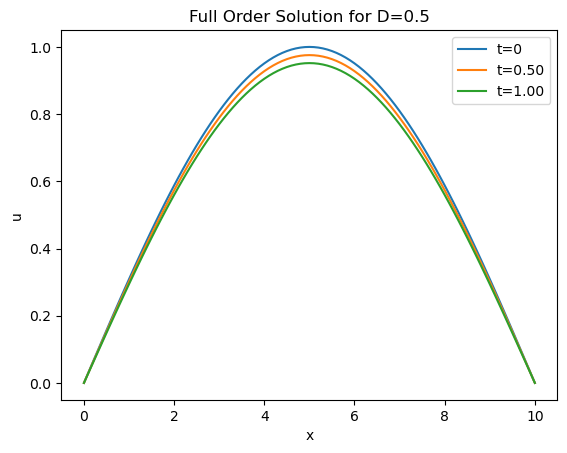

In [19]:
# Choose a D value not in D_values but within the interpolation range
D_test = 0.5  # 0.5 is between 0.1 and 2.0, and not in D_values

alpha_test = D_test * dt / dx**2
u_test = np.sin(np.pi * x / L)
u_test[0] = u_test[-1] = 0
u_test_all = [u_test.copy()]

for _ in range(Nt):
    u_new_test = u_test.copy()
    u_new_test[1:-1] = u_test[1:-1] + alpha_test * (u_test[2:] - 2*u_test[1:-1] + u_test[:-2])
    u_test = u_new_test
    u_test_all.append(u_test.copy())

# u_test_all contains the full order solution for D_test
plt.plot(x, u_test_all[0], label='t=0')
plt.plot(x, u_test_all[Nt//2], label=f't={T/2:.2f}')
plt.plot(x, u_test_all[-1], label=f't={T:.2f}')
plt.xlabel('x')
plt.ylabel('u')
plt.title(f'Full Order Solution for D={D_test}')
plt.legend()
plt.show()

In [22]:
# Project the initial condition u0 (for D_test) onto the dominant POD mode to get a1(0)
phi1 = U[:, 0]  # already computed in previous cells
u0_test = np.sin(np.pi * x / L)
a1_0 = np.dot(u0_test, phi1)

# Precompute the RHS for this D_test
rhs_rom_test = D_test * phi1T_d2_phi1_dx2

# Integrate the reduced coordinate a1(t) using the ODE: da1/dt = rhs_rom_test * a1
a1_rom = [a1_0]
for _ in range(Nt):
    a1_next = a1_rom[-1] + dt * rhs_rom_test * a1_rom[-1]
    a1_rom.append(a1_next)
a1_rom = np.array(a1_rom)

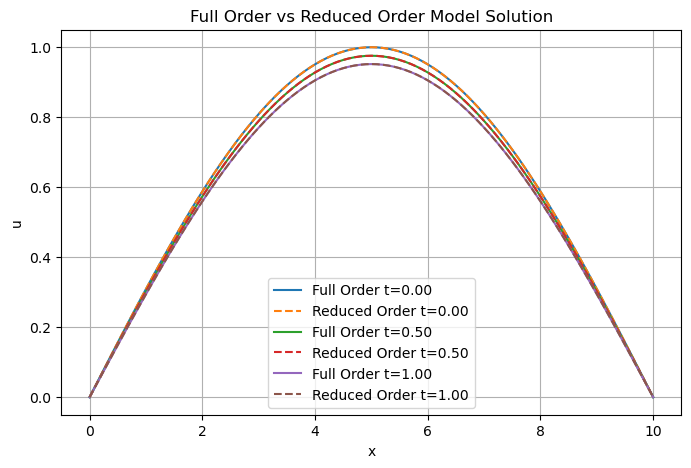

In [23]:
# Project the reduced order solution back to high dimension
# a1_rom is the time evolution of the reduced coordinate
# phi1 is the dominant POD mode

# Reconstruct the solution at each time step
u_rom_all = np.outer(a1_rom, phi1)  # shape: (Nt+1, Nx)

# Plot comparison at selected time steps
plt.figure(figsize=(8,5))
time_indices = [0, Nt//2, Nt]  # t=0, t=T/2, t=T

for idx in time_indices:
    plt.plot(x, u_test_all[idx], label=f'Full Order t={idx*dt:.2f}')
    plt.plot(x, u_rom_all[idx], '--', label=f'Reduced Order t={idx*dt:.2f}')

plt.xlabel('x')
plt.ylabel('u')
plt.title('Full Order vs Reduced Order Model Solution')
plt.legend()
plt.grid(True)
plt.show()